In [3]:
#HSV segmentation

In [4]:
%matplotlib inline

/Users/rolland/anaconda2/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [80]:
from matplotlib import pyplot as plt
from skimage import data,color, exposure,feature,io,measure
from skimage.segmentation import random_walker
from skimage.morphology import watershed
from skimage.feature import peak_local_max
from math import sqrt
from skimage.filters import threshold_otsu
from scipy import ndimage as ndi
from skimage.color import rgb2gray
import skimage.exposure as imexp
from PIL import Image
import numpy as np

In [6]:
#loading data

In [7]:
# im1 = Image.open('onlineSamples/textures/1.jpg')
# im2 = Image.open('onlineSamples/textures/2.jpg')
# im3 = Image.open('onlineSamples/textures/3.jpg')



onlineSamples = []
onlineHsvSamples = []

imgSamples = [];
imgHsvSamples = [];


for a in range(0,3):
    onlineSamples.append(np.array(Image.open('onlineSamples/textures/'+str(a+1)+'.jpg')))
                      
for b in range(0,3):
    onlineHsvSamples.append(color.rgb2hsv(onlineSamples[b]))

for c in range(0,18):
    imgSamples.append(np.array(Image.open('renamed-samples1/'+str(c+1)+'.bmp')))
                      
for d in range(0,18):
    imgHsvSamples.append(color.rgb2hsv(imgSamples[d]))


print(len(imgSamples))  
print(len(imgHsvSamples))  
print(len(onlineSamples))  
print(len(onlineHsvSamples))  
print(imgSamples[0].shape);
print(imgHsvSamples[0].shape);

18
18
3
3
(1080, 1920, 3)
(1080, 1920, 3)


In [8]:
#plotting

In [9]:
##saturation thresholding

In [10]:
def satThreshold(v,s):    ##return hue or intensity as dominant feature
    th = 1.0 - 0.8*v;
    if(s>th):
        return "h"
    else: 
        return "v"
    

In [11]:
def approximate(img):
    tmpImg = np.zeros(img.shape)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            dominantVal = satThreshold(img[i,j,2],img[i,j,1])
#             print("dominantVal----"+dominantVal)
            tmpImg[i,j,:] = img[i,j,:]
            if dominantVal == "h":
                tmpImg[i,j,0] = img[i,j,0]
                tmpImg[i,j,1] = 1.0
                tmpImg[i,j,2] = 1.0
                
            else:
                tmpImg[i,j,0] = 1.0
                tmpImg[i,j,1] = 1.0
                tmpImg[i,j,2] = img[i,j,2]
        
    return tmpImg

In [12]:
##ploating online samples

In [13]:
##extrac main component

In [14]:
def extractMainComp(approx_img):
    #0.12 green , #0.67 blue , #0,1 red
      return ( (approx_img[:,:,0] < 0.3))

In [15]:
##renyi antropy

In [72]:

def renyi_seg_fn(im,alpha):
    hist = imexp.histogram(im)
    
    #convert all values to float
    hist_float = [float(i) for i in hist[0]]
    
    #compute the pdf
    pdf = hist_float/np.sum(hist_float)
    
    #compute the cdf
    cumsum_pdf = np.cumsum(pdf)
    
    s = 0
    e = 255 # asuming 8 bit image
    scalar  = 1.0/(1-alpha)
    
    #A very small balue to prevent divition by zero
    eps = np.spacing(1)
    rr= e-s
    
    #the second parentheses is needed because the parameters are tuple
    h1 = np.zeros((rr,1))
    h2 = np.zeros((rr,1))
    
    #the following llop coputes h1 and h2 values used to compute the entropy
    for ii in range(1,rr):
        iidash = ii+s
        temp1 = np.power(pdf[1:iidash]+1/cumsum_pdf[iidash]+1,scalar)
        h1[ii] = np.log(np.sum(temp1)+eps)
        temp2 = np.power(pdf[iidash+1:255]+1/(1-cumsum_pdf[iidash])+1,scalar)
        h2[ii] = np.log(np.sum(temp2)+eps)
        
    T = h1 + h2
    
    #Entropy value is calculated 
    T = -T*scalar
    
    #location where the maximum entropy occurs is the threshold for the renyi entropy
#     location = T.argmax(axis=0)
    location = T.argmax()
    val = np.amax(T,axis=0)
    
    #show histogram
    
#     fig, axes= plt.subplots(1, 1, figsize=(10, 5), sharex=True, sharey=True)
    
#     axes.hist(location)
#     plt.show()
   
    
    #location value is used as the threshold
    thresh = location
    return val

In [16]:
def extractMainHsvComp(approx_img,hsv_img):
    
    tmpImg = np.zeros(hsv_img.shape)
    for i in range(hsv_img.shape[0]):
        for j in range(hsv_img.shape[1]):
            tmpImg[i,j,:] = hsv_img[i,j,:]
            if  not approx_img[i,j]: #turn to black
                tmpImg[i,j,0] = 0.
                tmpImg[i,j,1] = 0.
                tmpImg[i,j,2] = 0.      
        
    return tmpImg

In [17]:
##extract main hsv component based on approximated image result

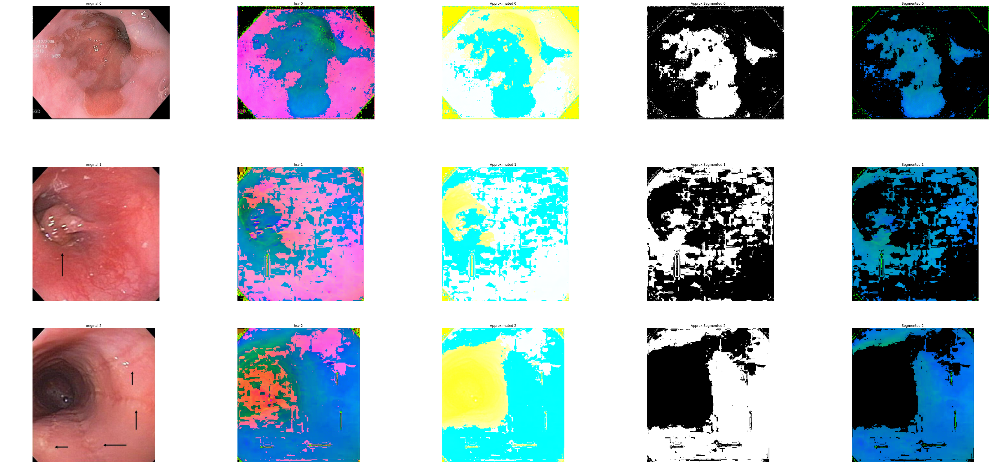

In [18]:
colnum = 5
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(onlineSamples)
# print(rownum)


fig, axes = plt.subplots(rownum, colnum, figsize=(65, rownum*10), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(onlineHsvSamples)):
    
    ax[index].imshow(onlineSamples[i],cmap='gray')
    ax[index].set_title("original "+str(i))
    ax[index].axis('off') 
    
    ax[index+1].imshow(onlineHsvSamples[i],cmap='gray')
    ax[index+1].set_title("hsv "+str(i))
    ax[index+1].axis('off') 
    
    ax[index+2].imshow(approximate(onlineHsvSamples[i]),cmap='gray')
    ax[index+2].set_title("Approximated "+str(i))
    ax[index+2].axis('off') 
    
    mainComp = extractMainComp(approximate(onlineHsvSamples[i]))
    ax[index+3].imshow(mainComp,cmap='gray')
    ax[index+3].set_title("Approx Segmented "+str(i))
    ax[index+3].axis('off')
    
        
    approximatedSeg = extractMainComp(approximate(onlineHsvSamples[i]))
    hsvSegmented = extractMainHsvComp(approximatedSeg,onlineHsvSamples[i])


    ax[index+4].imshow(hsvSegmented,cmap='gray')
    ax[index+4].set_title("Segmented "+str(i))
    ax[index+4].axis('off') 
    

    index +=5
    
plt.show()

In [19]:
## gray level image

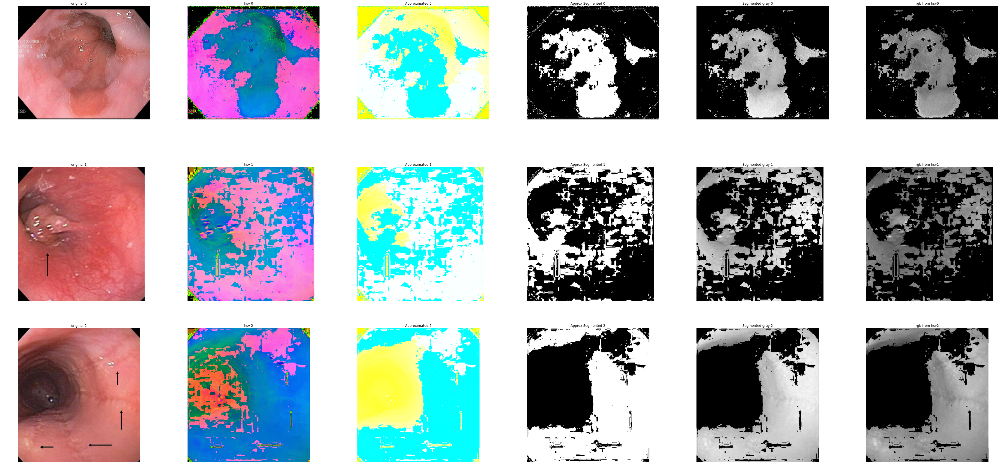

In [25]:
colnum = 6
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(onlineSamples)
# print(rownum)


fig, axes = plt.subplots(rownum, colnum, figsize=(65, rownum*10), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(onlineHsvSamples)):
    
    ax[index].imshow(onlineSamples[i],cmap='gray')
    ax[index].set_title("original "+str(i))
    ax[index].axis('off') 
    
    ax[index+1].imshow(onlineHsvSamples[i],cmap='gray')
    ax[index+1].set_title("hsv "+str(i))
    ax[index+1].axis('off') 
    
    ax[index+2].imshow(approximate(onlineHsvSamples[i]),cmap='gray')
    ax[index+2].set_title("Approximated "+str(i))
    ax[index+2].axis('off') 
    
    mainComp = extractMainComp(approximate(onlineHsvSamples[i]))
    ax[index+3].imshow(mainComp,cmap='gray')
    ax[index+3].set_title("Approx Segmented "+str(i))
    ax[index+3].axis('off')
    
        
    approximatedSeg = extractMainComp(approximate(onlineHsvSamples[i]))
    hsvSegmented = extractMainHsvComp(approximatedSeg,onlineHsvSamples[i])
    

    ax[index+4].imshow(hsvSegmented[:,:,2],cmap='gray')
    ax[index+4].set_title("Segmented gray "+str(i))
    ax[index+4].axis('off') 
    

    
    ax[index+5].imshow(rgb2gray(color.hsv2rgb(hsvSegmented)),cmap='gray')
    ax[index+5].set_title("rgb from hsv"+str(i))
    ax[index+5].axis('off') 
    

    index +=6
    
plt.show()

In [38]:
##watter shed algorithm

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]]


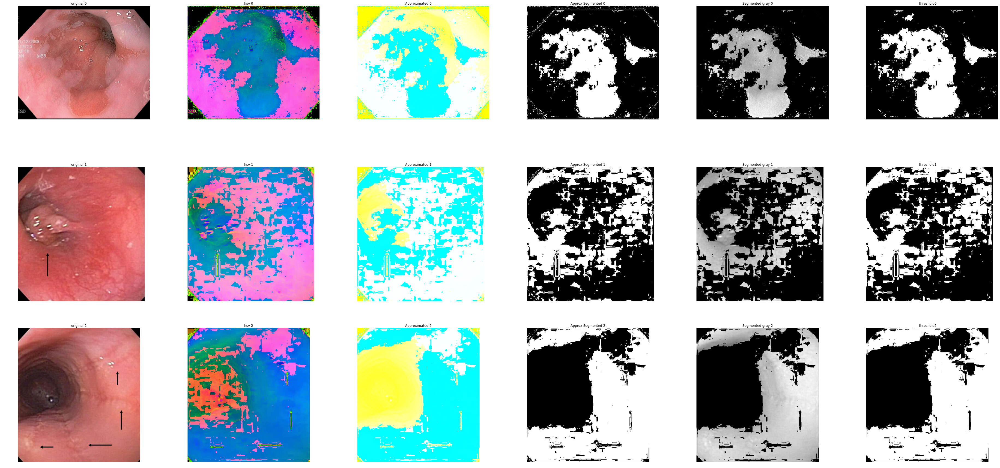

In [82]:


colnum = 6
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(onlineSamples)
# print(rownum)


fig, axes = plt.subplots(rownum, colnum, figsize=(65, rownum*10), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(onlineHsvSamples)):
    
    ax[index].imshow(onlineSamples[i],cmap='gray')
    ax[index].set_title("original "+str(i))
    ax[index].axis('off') 
    
    ax[index+1].imshow(onlineHsvSamples[i],cmap='gray')
    ax[index+1].set_title("hsv "+str(i))
    ax[index+1].axis('off') 
    
    ax[index+2].imshow(approximate(onlineHsvSamples[i]),cmap='gray')
    ax[index+2].set_title("Approximated "+str(i))
    ax[index+2].axis('off') 
    
    mainComp = extractMainComp(approximate(onlineHsvSamples[i]))
    ax[index+3].imshow(mainComp,cmap='gray')
    ax[index+3].set_title("Approx Segmented "+str(i))
    ax[index+3].axis('off')
    
        
    approximatedSeg = extractMainComp(approximate(onlineHsvSamples[i]))
    hsvSegmented = extractMainHsvComp(approximatedSeg,onlineHsvSamples[i])
    

    ax[index+4].imshow(hsvSegmented[:,:,2],cmap='gray')
    ax[index+4].set_title("Segmented gray "+str(i))
    ax[index+4].axis('off') 
    
    
    # image = rgb2gray(color.hsv2rgb(hsvSegmented))
    image = hsvSegmented[:,:,2]
    
    thresh = threshold_otsu(image)

    threshImg = image >= thresh

    
    ax[index+5].imshow(threshImg,cmap='gray')
    ax[index+5].set_title(" threshold"+str(i))
    ax[index+5].axis('off') 
    

    index +=6

print(image)
    
plt.show()



In [83]:
#local images

18


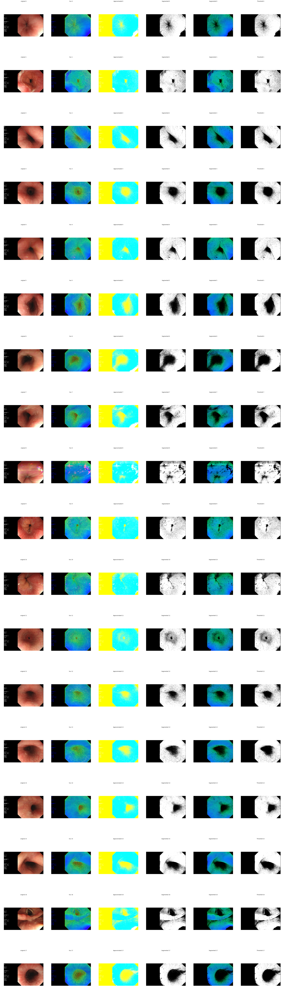

In [84]:
colnum = 6
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(imgSamples)
print(rownum)


fig, axes = plt.subplots(rownum, colnum, figsize=(50, rownum*10), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(imgHsvSamples)):
    
    ax[index].imshow(imgSamples[i],cmap='gray')
    ax[index].set_title("original "+str(i))
    ax[index].axis('off') 
    
    ax[index+1].imshow(imgHsvSamples[i],cmap='gray')
    ax[index+1].set_title("hsv "+str(i))
    ax[index+1].axis('off') 
    
    ax[index+2].imshow(approximate(imgHsvSamples[i]),cmap='gray')
    ax[index+2].set_title("Approximated "+str(i))
    ax[index+2].axis('off') 
    
    
    ax[index+3].imshow(extractMainComp(approximate(imgHsvSamples[i])),cmap='gray')
    ax[index+3].set_title("Segmented "+str(i))
    ax[index+3].axis('off')
    

    approximatedSeg = extractMainComp(approximate(imgHsvSamples[i]))
    hsvSegmented = extractMainHsvComp(approximatedSeg,imgHsvSamples[i])
    ax[index+4].imshow(hsvSegmented,cmap='gray')
    ax[index+4].set_title("Segmented "+str(i))
    ax[index+4].axis('off') 
    
        
    # image = rgb2gray(color.hsv2rgb(hsvSegmented))
    image = hsvSegmented[:,:,2]
    
    thresh = threshold_otsu(image)

    threshImg = image >= thresh
    
    ax[index+5].imshow(threshImg,cmap='gray')
    ax[index+5].set_title("Threshold "+str(i))
    ax[index+5].axis('off') 
    
    index +=6
    
plt.show()